In [1]:
import pandas as pd
import folium
import json
import matplotlib.pyplot as plt
import seaborn as sns
from string import ascii_letters
import numpy as np
import geopandas as gpd

In [2]:
df_alimentacao = pd.read_csv('dados/alimentacao.csv')

In [3]:
df_alimentacao.head()

,id,UF,Esperança de vida ao nascer (Anos),Situação Censitária,Área,Peso Final,Altura Final,Está grávida?,Em quantos dias da semana costuma substituir a refeição do almoço por lanches rápidos?,"Considerando a comida preparada na hora e os alimentos industrializados,acha que o seu consumo de sal é:",dias_semana_leguminosas e verduras,dias_semana_carnes,dias_semana_bebida artificial,dias_semana_bebida natural,dias_semana_frutas,dias_semana_leite,dias_semana_doces industrializados
0,0,RO,71.91,1,1,60.0,145.0,2.0,0.0,3.0,4.0,4.000000,4.0,0.0,3.0,7.0,0.0
1,9,RO,71.91,1,1,65.0,152.0,2.0,0.0,3.0,5.5,2.000000,1.0,0.0,0.0,0.0,0.0
2,10,RO,71.91,1,1,77.0,155.0,2.0,0.0,4.0,7.0,3.333333,0.0,7.0,7.0,0.0,0.0
3,18,RO,71.91,1,1,56.0,159.0,2.0,0.0,3.0,5.0,4.333333,1.5,3.0,3.0,0.0,0.0
4,19,RO,71.91,1,1,55.0,176.0,2.0,0.0,3.0,3.0,2.000000,1.5,4.0,3.0,7.0,2.0


In [4]:
df_alimentacao.shape

(90846, 17)

In [5]:
df_alimentacao.columns

Index(['id', 'UF', 'Esperança de vida ao nascer (Anos)', 'Situação Censitária',
       'Área', 'Peso Final', 'Altura Final', 'Está grávida?',
       'Em quantos dias da semana costuma substituir a refeição do almoço por lanches rápidos?',
       'Considerando a comida preparada na hora e os alimentos industrializados,acha que o seu consumo de sal é:',
       'dias_semana_leguminosas e verduras', 'dias_semana_carnes',
       'dias_semana_bebida artificial', 'dias_semana_bebida natural',
       'dias_semana_frutas', 'dias_semana_leite',
       'dias_semana_doces industrializados'],
      dtype='object')

In [6]:
df_alimentacao = df_alimentacao.drop(columns = ['Está grávida?', 'Considerando a comida preparada na hora e os alimentos industrializados,acha que o seu consumo de sal é:'])

In [7]:
df_corr = df_alimentacao.drop(columns = ['UF'])

In [8]:
df_corr['Situação Censitária'] = df_corr['Situação Censitária'].replace({1: 'Urbano', 2: 'Rural'})

df_dummies1 = pd.get_dummies(df_corr['Situação Censitária'])

df_dummies = pd.concat([df_corr, df_dummies1], axis=1)

df_dummies.drop(columns = ['Situação Censitária'], inplace = True)

df_dummies

,id,Esperança de vida ao nascer (Anos),Área,Peso Final,Altura Final,Em quantos dias da semana costuma substituir a refeição do almoço por lanches rápidos?,dias_semana_leguminosas e verduras,dias_semana_carnes,dias_semana_bebida artificial,dias_semana_bebida natural,dias_semana_frutas,dias_semana_leite,dias_semana_doces industrializados,Rural,Urbano
0,0,71.91,1,60.0,145.0,0.0,4.0,4.000000,4.0,0.0,3.0,7.0,0.0,0,1
1,9,71.91,1,65.0,152.0,0.0,5.5,2.000000,1.0,0.0,0.0,0.0,0.0,0,1
2,10,71.91,1,77.0,155.0,0.0,7.0,3.333333,0.0,7.0,7.0,0.0,0.0,0,1
3,18,71.91,1,56.0,159.0,0.0,5.0,4.333333,1.5,3.0,3.0,0.0,0.0,0,1
4,19,71.91,1,55.0,176.0,0.0,3.0,2.000000,1.5,4.0,3.0,7.0,2.0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90841,293709,78.85,1,63.0,168.0,0.0,7.0,1.666667,0.5,7.0,2.0,0.0,0.0,1,0
90842,293712,78.85,1,72.0,168.0,0.0,7.0,5.333333,0.0,2.0,3.0,0.0,0.0,1,0
90843,293713,78.85,1,87.0,163.0,0.0,4.5,2.000000,0.5,0.0,1.0,7.0,7.0,1,0
90844,293718,78.85,1,89.0,168.0,0.0,4.5,2.000000,3.0,4.0,3.0,0.0,0.0,1,0


In [9]:
df_dummies.to_csv('bases_agrupadas/alimentacao.csv')

<Axes: >

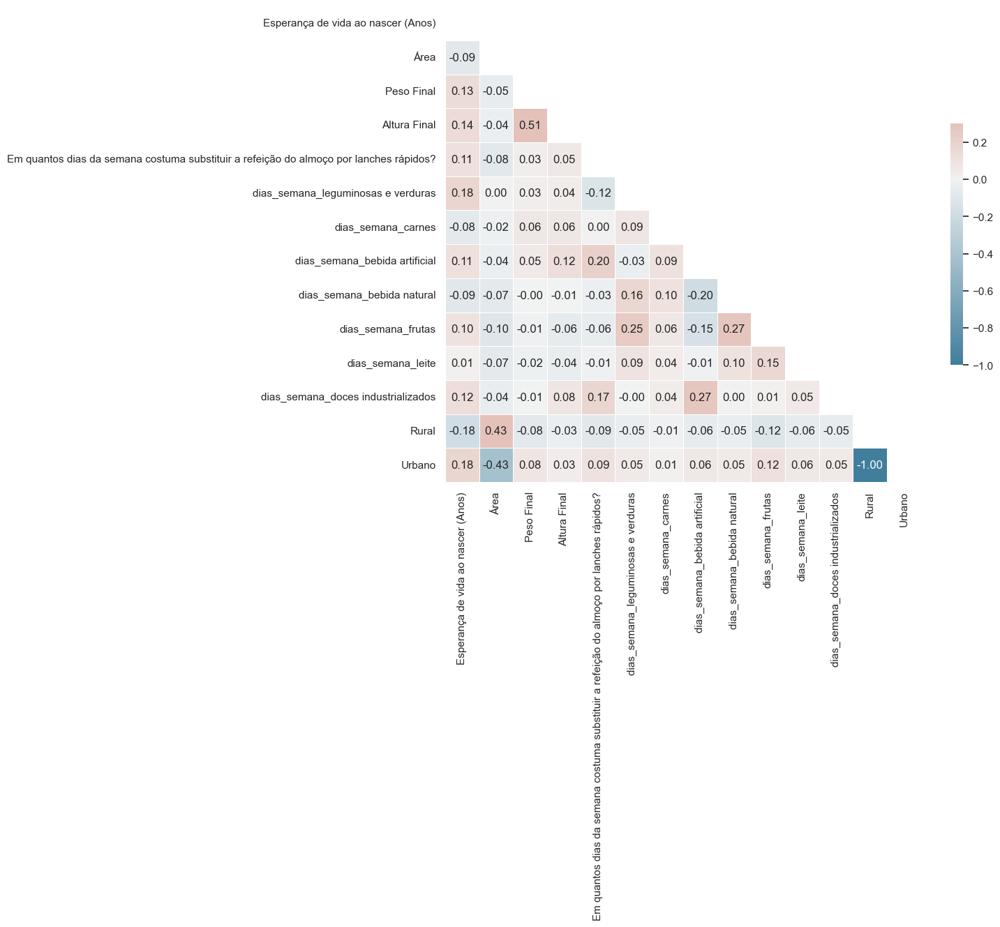

In [10]:
sns.set_theme(style="white")

df_dummies.drop(columns = ['id'], inplace = True)
 
# Compute the correlation matrix
corr = df_dummies.corr()
 
# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))
 
# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))
 
# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)
 
# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True, fmt=".2f")

In [11]:
pessoas_uf = df_alimentacao.groupby('UF').size().reset_index(name='count').sort_values(by='count', ascending=False)
pessoas_uf

,UF,count
25,SP,6114
10,MG,5209
9,MA,5080
18,RJ,4966
5,CE,4265
15,PE,4083
17,PR,3967
13,PA,3853
22,RS,3767
23,SC,3738


In [12]:
almoco_lanche_uf = df_alimentacao.groupby('UF')['Em quantos dias da semana costuma substituir a refeição do almoço por lanches rápidos?'].mean().reset_index()
almoco_lanche_uf

,UF,Em quantos dias da semana costuma substituir a refeição do almoço por lanches rápidos?
0,AC,0.275210
1,AL,0.401071
2,AM,0.382006
3,AP,0.315959
4,BA,0.327685
5,CE,0.359203
6,DF,0.517548
7,ES,0.397063
8,GO,0.456329
9,MA,0.262402


In [13]:
leguminosas_verdura_uf = df_alimentacao.groupby('UF')['dias_semana_leguminosas e verduras'].mean().reset_index()
leguminosas_verdura_uf

,UF,dias_semana_leguminosas e verduras
0,AC,4.144748
1,AL,4.840978
2,AM,3.411469
3,AP,3.749678
4,BA,4.742006
5,CE,4.463189
6,DF,5.190698
7,ES,5.394521
8,GO,5.423760
9,MA,3.714370


In [14]:
carne_uf = df_alimentacao.groupby('UF')['dias_semana_carnes'].mean().reset_index()
carne_uf

,UF,dias_semana_carnes
0,AC,2.634034
1,AL,2.533199
2,AM,2.732490
3,AP,2.646718
4,BA,2.400747
5,CE,2.201329
6,DF,2.524736
7,ES,2.326179
8,GO,2.654083
9,MA,2.435827


In [15]:
bebidas_artificiais_uf = df_alimentacao.groupby('UF')['dias_semana_bebida artificial'].mean().reset_index()
bebidas_artificiais_uf

,UF,dias_semana_bebida artificial
0,AC,1.338025
1,AL,1.028457
2,AM,1.238574
3,AP,1.443372
4,BA,0.704017
5,CE,1.007503
6,DF,1.181818
7,ES,0.961734
8,GO,1.561991
9,MA,0.765453


In [16]:
bebidas_naturais_uf = df_alimentacao.groupby('UF')['dias_semana_bebida natural'].mean().reset_index()
bebidas_naturais_uf

,UF,dias_semana_bebida natural
0,AC,2.615546
1,AL,3.265484
2,AM,2.640701
3,AP,2.662162
4,BA,3.401476
5,CE,3.015006
6,DF,2.880761
7,ES,2.592206
8,GO,2.217246
9,MA,2.201772


In [17]:
frutas_uf = df_alimentacao.groupby('UF')['dias_semana_frutas'].mean().reset_index()
frutas_uf

,UF,dias_semana_frutas
0,AC,3.366387
1,AL,3.958152
2,AM,3.645300
3,AP,3.687902
4,BA,3.960918
5,CE,3.971864
6,DF,4.595349
7,ES,4.020898
8,GO,3.905255
9,MA,3.636024


In [18]:
leite_uf = df_alimentacao.groupby('UF')['dias_semana_leite'].mean().reset_index()
leite_uf

,UF,dias_semana_leite
0,AC,4.080252
1,AL,2.843321
2,AM,3.685829
3,AP,4.254826
4,BA,4.000000
5,CE,3.421102
6,DF,3.271036
7,ES,3.384355
8,GO,3.343079
9,MA,3.639370


In [19]:
doces_uf = df_alimentacao.groupby('UF')['dias_semana_doces industrializados'].mean().reset_index()
doces_uf

,UF,dias_semana_doces industrializados
0,AC,1.414706
1,AL,1.502176
2,AM,1.292325
3,AP,1.561133
4,BA,1.501503
5,CE,1.769285
6,DF,1.734461
7,ES,1.799209
8,GO,1.725389
9,MA,1.070276


In [20]:
# Carregar o geojson das UFs
with open(r'dados\uf.json', encoding='ISO-8859-1') as f:
    geojson_data = json.load(f)

# Criar o mapa base
m = folium.Map(location=(-14.2350, -51.9253), zoom_start=4, tiles='Cartodb Positron', control_scale=True)

choropleth1 = folium.Choropleth(
    geo_data=geojson_data,
    data=pessoas_uf,
    columns=['UF', 'count'],
    key_on='feature.properties.UF_05',
    fill_color='Oranges',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Quantidade de Pessoas por UF',
    name='Quantidade de Pessoas por UF',
    show=False
).add_to(m)

choropleth2 = folium.Choropleth(
    geo_data=geojson_data,
    data=almoco_lanche_uf,
    columns=['UF', 'Em quantos dias da semana costuma substituir a refeição do almoço por lanches rápidos?'],
    key_on='feature.properties.UF_05',
    fill_color='Oranges',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Média Substituição do Almoço por Lanches Rápidos',
    name='Média Substituição do Almoço por Lanches Rápidos',
    show=False
).add_to(m)

choropleth3 = folium.Choropleth(
    geo_data=geojson_data,
    data=leguminosas_verdura_uf,
    columns=['UF', 'dias_semana_leguminosas e verduras'],
    key_on='feature.properties.UF_05',
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Média Consumo de Leguminosas e Verduras',
    name='Média Consumo de Leguminosas e Verduras',
    show=False
).add_to(m)

choropleth4 = folium.Choropleth(
    geo_data=geojson_data,
    data=carne_uf,
    columns=['UF', 'dias_semana_carnes'],
    key_on='feature.properties.UF_05',
    fill_color='Reds',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Média Consumo de Carnes',
    name='Média Consumo de Carnes',
    show=False
).add_to(m)

choropleth5 = folium.Choropleth(
    geo_data=geojson_data,
    data=bebidas_artificiais_uf,
    columns=['UF', 'dias_semana_bebida artificial'],
    key_on='feature.properties.UF_05',
    fill_color='Purples',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Média Consumo de Bebidas Artificiais',
    name = 'Média Consumo de Bebidas Artificiais',
    show = False
).add_to(m)

choropleth6 = folium.Choropleth(
    geo_data=geojson_data,
    data=bebidas_naturais_uf,
    columns=['UF', 'dias_semana_bebida natural'],
    key_on='feature.properties.UF_05',
    fill_color='YlOrBr',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Média Consumo de Bebidas Naturais',
    name = 'Média Consumo de Bebidas Naturais',
    show = False
).add_to(m)

choropleth7 = folium.Choropleth(
    geo_data=geojson_data,
    data=frutas_uf,
    columns=['UF', 'dias_semana_frutas'],
    key_on='feature.properties.UF_05',
    fill_color='GnBu',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Média Consumo de Frutas',
    name = 'Média Consumo de Frutas',
    show = False
).add_to(m)

choropleth8 = folium.Choropleth(
    geo_data=geojson_data,
    data=leite_uf,
    columns=['UF', 'dias_semana_leite'],
    key_on='feature.properties.UF_05',
    fill_color='YlOrBr',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Média Consumo de Leite',
    name = 'Média Consumo de Leite',
    show = False
).add_to(m)

choropleth = folium.Choropleth(
    geo_data=geojson_data,
    data=doces_uf,
    columns=['UF', 'dias_semana_doces industrializados'],
    key_on='feature.properties.UF_05',
    fill_color='OrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Média Consumo de Doces',
    name = 'Média Consumo de Doces',
    show = False
).add_to(m)

# Adicionar o controle de camadas para alternar entre as camadas
folium.LayerControl(collapsed=True).add_to(m)

# Salvar o mapa em um arquivo HTML
# m.save('mapa_com_camadas_coropletico.html')

# Exibir o mapa
m


In [21]:
malha = gpd.read_file(r'dados\uf.json', encoding='ISO-8859-1')
malha = malha.set_index('UF_05')

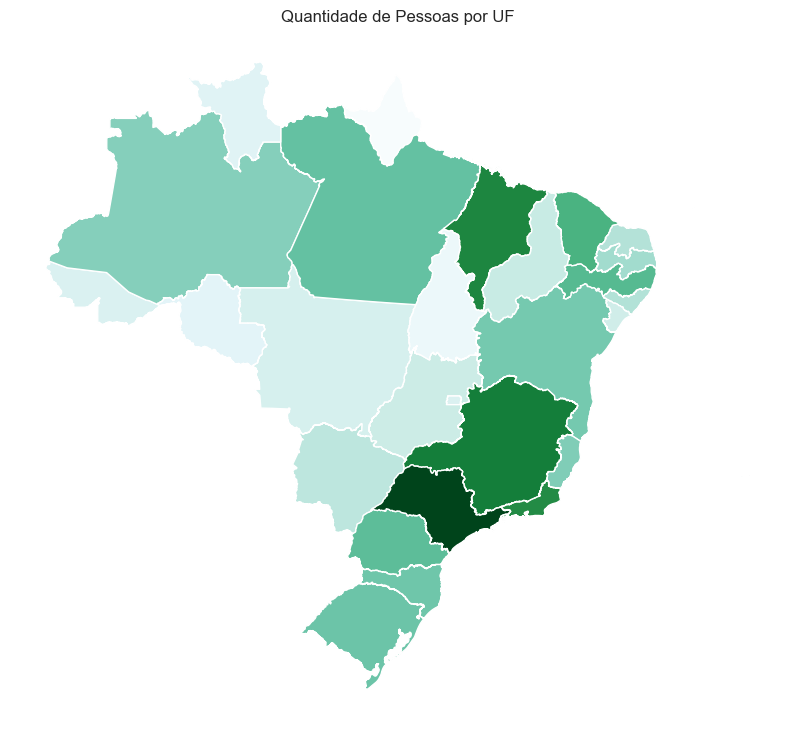

<Figure size 640x480 with 0 Axes>

In [43]:
pessoas_uf_mapa = malha.join(pessoas_uf.set_index('UF'))
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

vmin, vmax = pessoas_uf_mapa['count'].min() * 0.8, pessoas_uf_mapa['count'].max() * 1.2

pessoas_uf_mapa.plot(column='count', ax=ax,
                cmap='BuGn')

ax.set_title("Quantidade de Pessoas por UF")
ax.axis('off')

# Garantir que o gráfico foi renderizado corretamente
plt.draw()

# Mostrar o gráfico
plt.show()

# Agora salvar o gráfico após o show
plt.savefig('imagens/pessoas_uf_mapa.png', transparent=True, bbox_inches='tight', pad_inches=0)

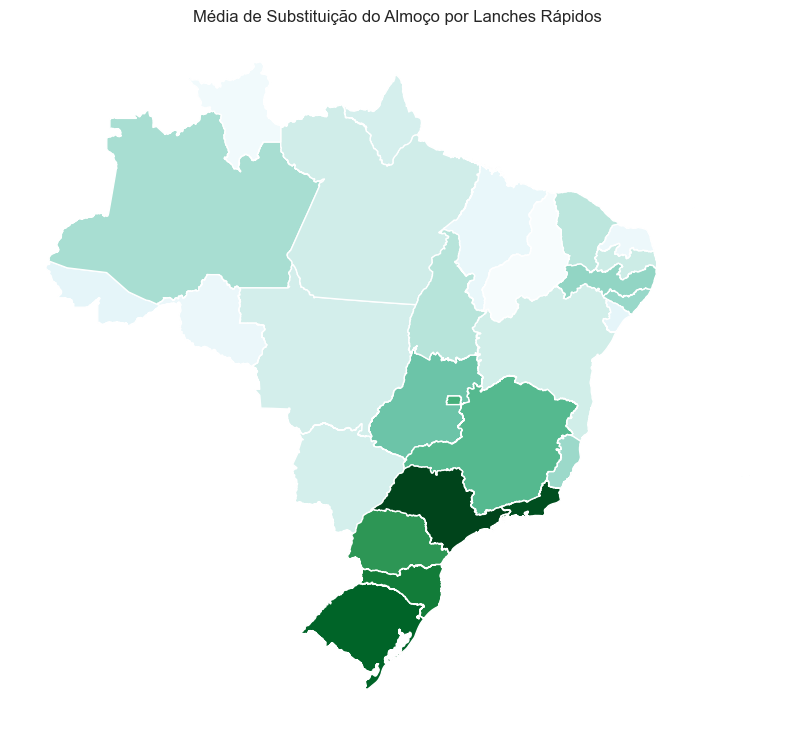

In [23]:
almoco_lanche_uf_mapa = malha.join(almoco_lanche_uf.set_index('UF'))
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

vmin, vmax = almoco_lanche_uf_mapa['Em quantos dias da semana costuma substituir a refeição do almoço por lanches rápidos?'].min() * 0.8, almoco_lanche_uf_mapa['Em quantos dias da semana costuma substituir a refeição do almoço por lanches rápidos?'].max() * 1.2

almoco_lanche_uf_mapa.plot(column='Em quantos dias da semana costuma substituir a refeição do almoço por lanches rápidos?', ax=ax,
                cmap='BuGn')

ax.set_title("Média de Substituição do Almoço por Lanches Rápidos")
ax.axis('off')
plt.show()

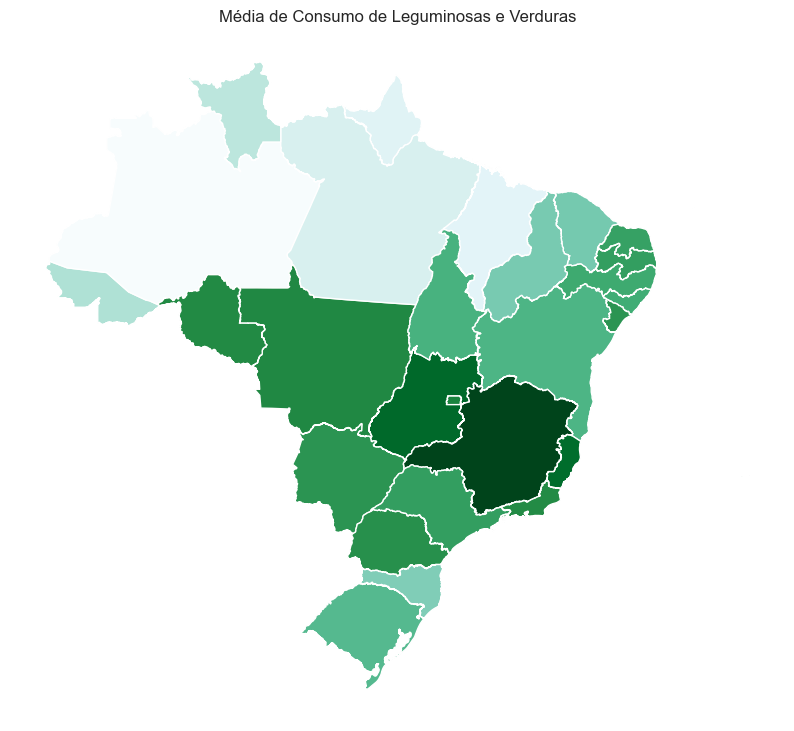

In [24]:
leguminosas_verdura_uf_mapa = malha.join(leguminosas_verdura_uf.set_index('UF'))
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

vmin, vmax = leguminosas_verdura_uf_mapa['dias_semana_leguminosas e verduras'].min() * 0.8, leguminosas_verdura_uf_mapa['dias_semana_leguminosas e verduras'].max() * 1.2

leguminosas_verdura_uf_mapa.plot(column='dias_semana_leguminosas e verduras', ax=ax,
                cmap='BuGn')

ax.set_title("Média de Consumo de Leguminosas e Verduras")
ax.axis('off')
plt.show()

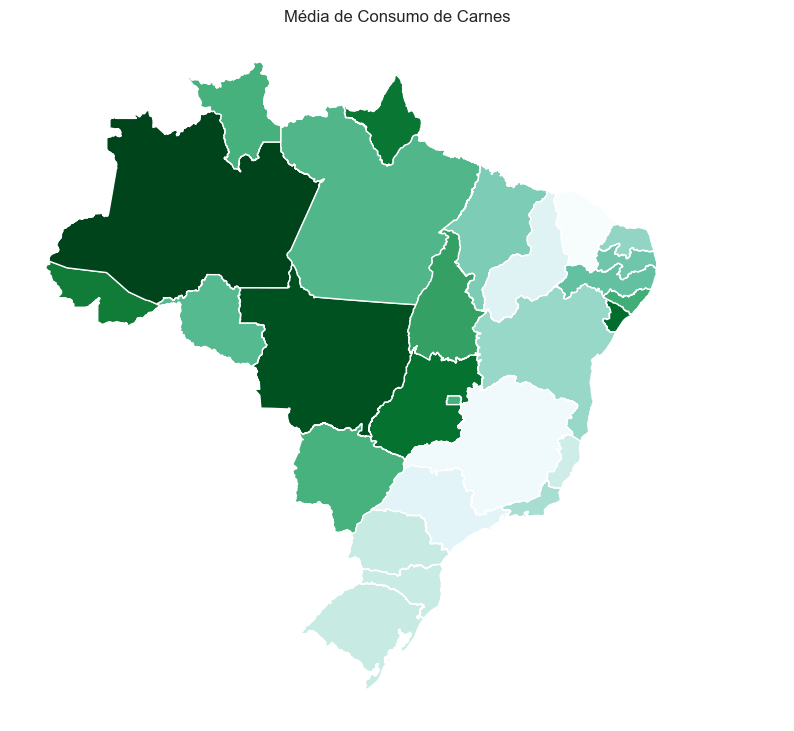

In [25]:
carne_uf_mapa = malha.join(carne_uf.set_index('UF'))
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

vmin, vmax = carne_uf_mapa['dias_semana_carnes'].min() * 0.8, carne_uf_mapa['dias_semana_carnes'].max() * 1.2

carne_uf_mapa.plot(column='dias_semana_carnes', ax=ax,
                cmap='BuGn')

ax.set_title("Média de Consumo de Carnes")
ax.axis('off')
plt.show()

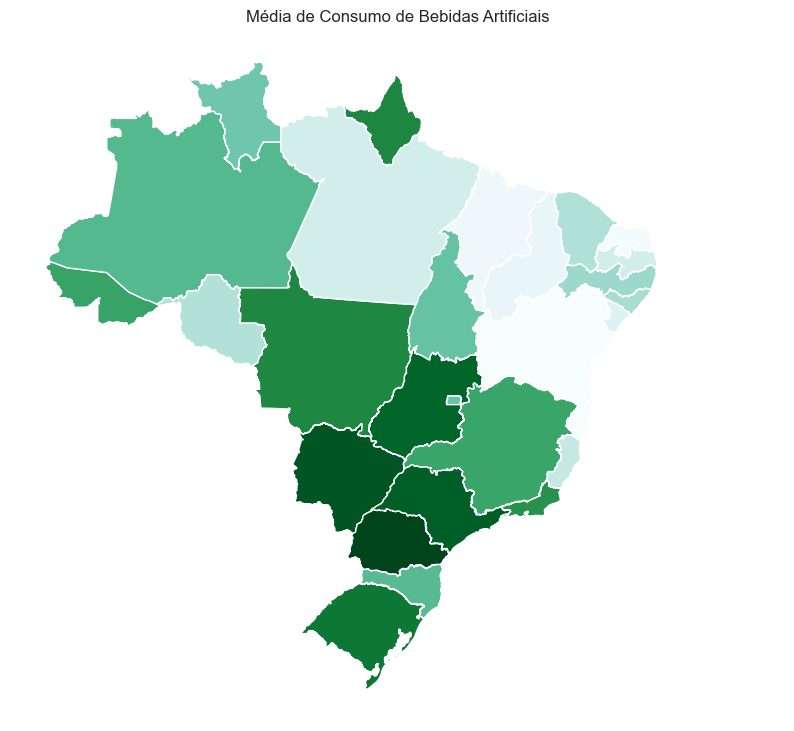

In [26]:
bebidas_artificiais_uf_mapa = malha.join(bebidas_artificiais_uf.set_index('UF'))
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

vmin, vmax = bebidas_artificiais_uf_mapa['dias_semana_bebida artificial'].min() * 0.8, bebidas_artificiais_uf_mapa['dias_semana_bebida artificial'].max() * 1.2

bebidas_artificiais_uf_mapa.plot(column='dias_semana_bebida artificial', ax=ax,
                cmap='BuGn')

ax.set_title("Média de Consumo de Bebidas Artificiais")
ax.axis('off')
plt.show()

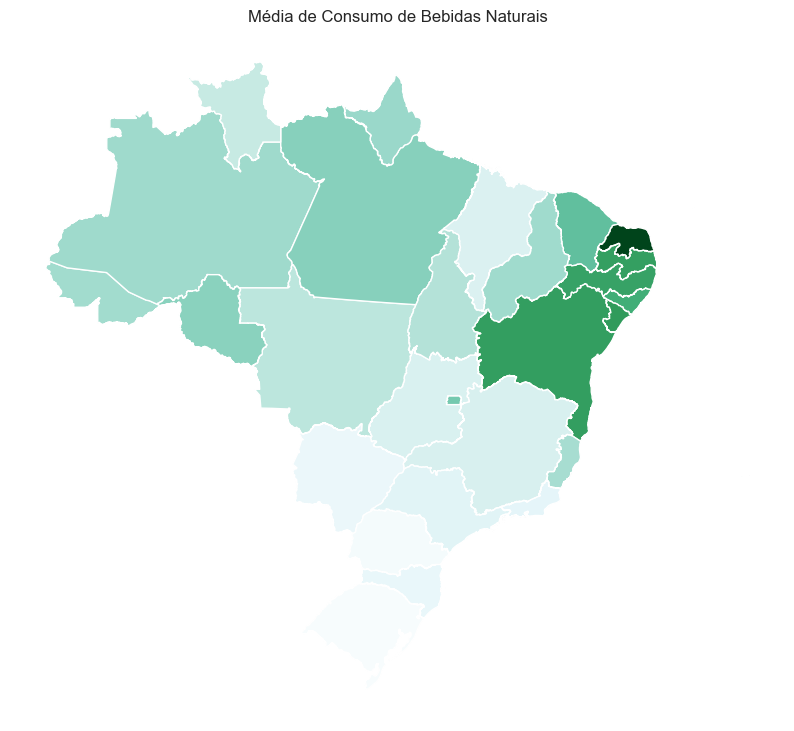

In [27]:
bebidas_naturais_uf_mapa = malha.join(bebidas_naturais_uf.set_index('UF'))
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

vmin, vmax = bebidas_naturais_uf_mapa['dias_semana_bebida natural'].min() * 0.8, bebidas_naturais_uf_mapa['dias_semana_bebida natural'].max() * 1.2

bebidas_naturais_uf_mapa.plot(column='dias_semana_bebida natural', ax=ax,
                cmap='BuGn')

ax.set_title("Média de Consumo de Bebidas Naturais")
ax.axis('off')
plt.show()

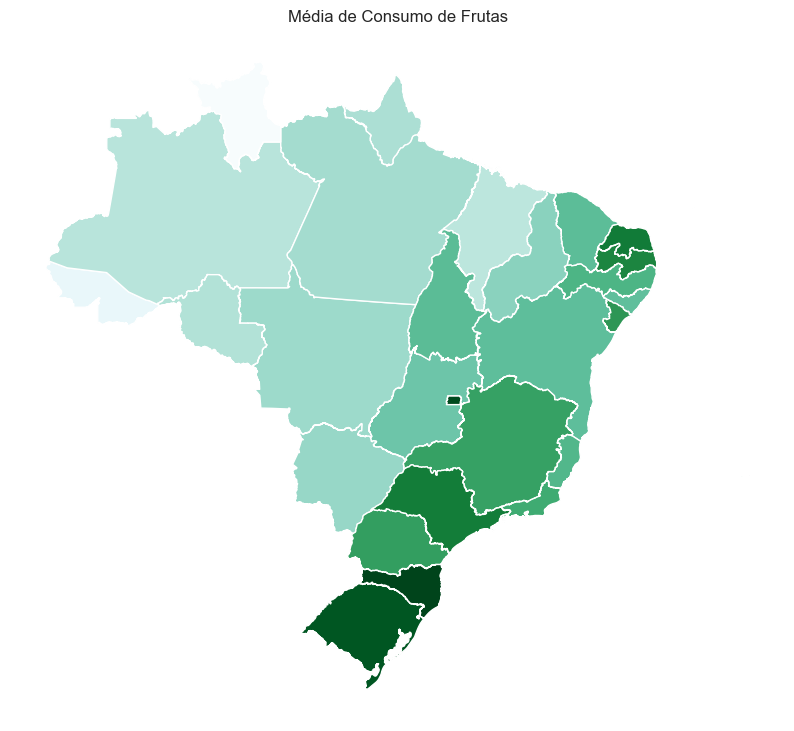

In [28]:
frutas_uf_mapa = malha.join(frutas_uf.set_index('UF'))
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

vmin, vmax = frutas_uf_mapa['dias_semana_frutas'].min() * 0.8, frutas_uf_mapa['dias_semana_frutas'].max() * 1.2

frutas_uf_mapa.plot(column='dias_semana_frutas', ax=ax,
                cmap='BuGn')

ax.set_title("Média de Consumo de Frutas")
ax.axis('off')
plt.show()

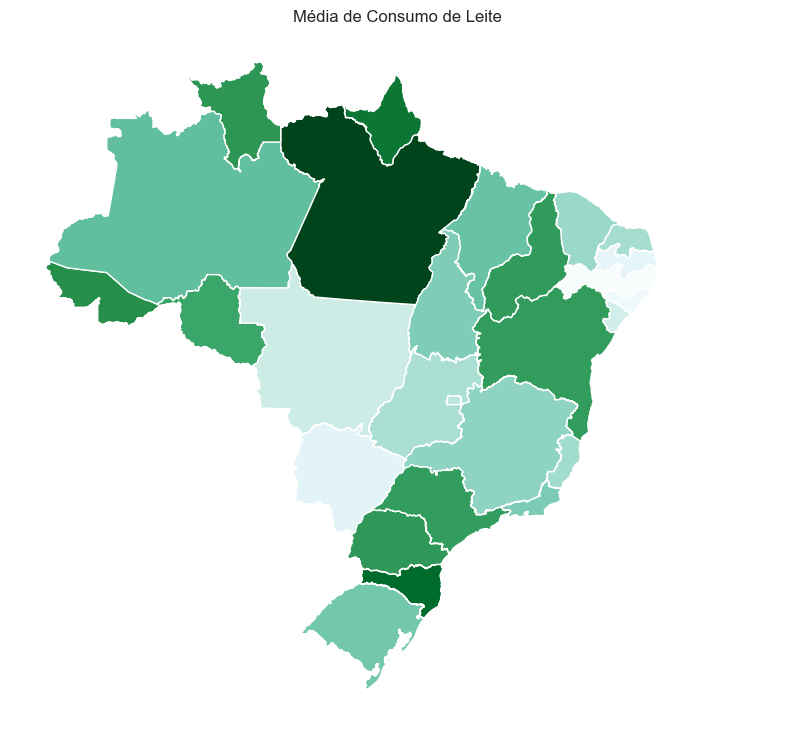

In [29]:
leite_uf_mapa = malha.join(leite_uf.set_index('UF'))
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

vmin, vmax = leite_uf_mapa['dias_semana_leite'].min() * 0.8, leite_uf_mapa['dias_semana_leite'].max() * 1.2

leite_uf_mapa.plot(column='dias_semana_leite', ax=ax,
                cmap='BuGn')

ax.set_title("Média de Consumo de Leite")
ax.axis('off')
plt.show()

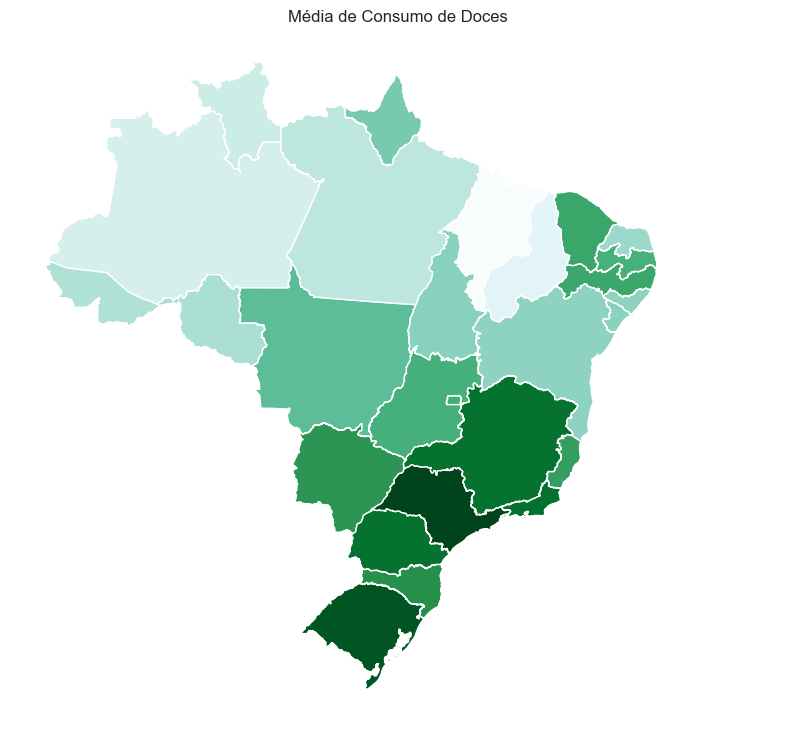

In [30]:
doces_uf_mapa = malha.join(doces_uf.set_index('UF'))
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

vmin, vmax = doces_uf_mapa['dias_semana_doces industrializados'].min() * 0.8, doces_uf_mapa['dias_semana_doces industrializados'].max() * 1.2

doces_uf_mapa.plot(column='dias_semana_doces industrializados', ax=ax,
                cmap='BuGn')

ax.set_title("Média de Consumo de Doces")
ax.axis('off')
plt.show()